# Using a Jupyter Notebook to perform a nanopublication analysis over NeXtProt dataset

Imran Asif ([ORCID:0000-0002-1144-6265](https://orcid.org/0000-0002-1144-6265))  
PhD Student, Computer Science

_Heriot-Watt University, Edinburgh, UK_

__Information:__ I have basic information about how much nanopublications are published on different servers. the following graph shows the total number of nanopublications among different datasets

## Utility Functions ##

In [2]:
from SPARQLWrapper import SPARQLWrapper, JSON
#Define local DisGeNet SPARQL endpoint and function to run queries over it
dbSparql = SPARQLWrapper("http://localhost:8890/sparql/")
dbSparql.setReturnFormat(JSON)
def queryDisGeNET(query):
    dbSparql.setQuery(query)
    results = dbSparql.queryAndConvert()
    return results

# Define function to extract count result from JSON SPARQL result set
def extract_count(results):
    """
    Extract the count result from the JSON format
    """
    for result in results["results"]["bindings"]:
        return result["count"]["value"]
    
#Initialise counts dictionary to store count for each dataset in
counts = {}

In [3]:
import seaborn as sns
import pygal
from IPython.display import SVG, display
from ipywidgets import HTML

## Assertion Distribution ##


In [5]:
query = """
prefix np: <http://www.nanopub.org/nschema#>

    select count(*) as ?count where {
      graph ?h {
        ?_np_iri a np:Nanopublication ;
          np:hasAssertion ?a .
      }
      graph ?a {?s ?p ?o}
    } 
    GROUP BY ?a
"""

results = queryDisGeNET(query)

In [6]:
assertions = []
for result in results["results"]["bindings"]:
    value = int(result["count"]["value"])
    assertions.append(value)

[Text(0, 0.5, 'Number of Triples'), Text(0.5, 0, 'Assertion Graph')]

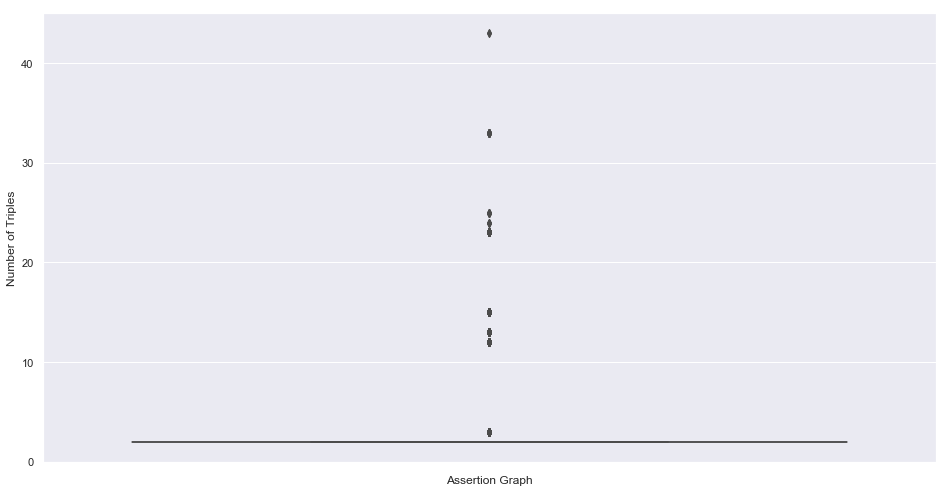

In [7]:
assertions.sort()
sns.set(style="whitegrid")
sns.set(rc={'figure.figsize':(16,8.27)})
data = assertions
ax = sns.boxplot(y=data)
ax.set(xlabel='Assertion Graph', ylabel='Number of Triples')

## Provenance Triples ##

In [8]:
query = """
prefix np: <http://www.nanopub.org/nschema#>

    select count(*) as ?count where {
      graph ?h {
        ?_np_iri a np:Nanopublication ;
          np:hasProvenance ?prov .
      }
      graph ?prov {?s ?p ?o}
    } 
    GROUP BY ?prov
"""

results = queryDisGeNET(query)

In [9]:
provenanceTriples = []
index = 0
for result in results["results"]["bindings"]:
    value = int(result["count"]["value"])
    provenanceTriples.append(value)

[Text(0, 0.5, 'Number of Triples'), Text(0.5, 0, 'Provenance Graph')]

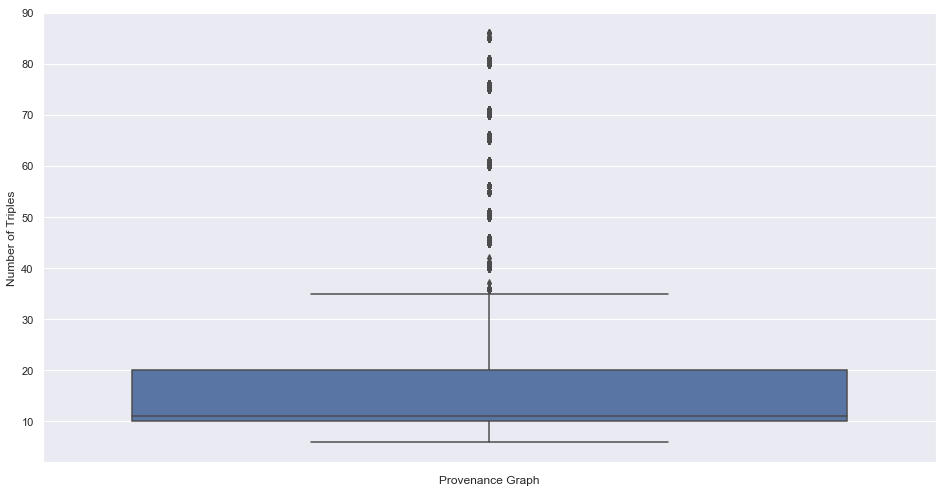

In [10]:
provenanceTriples.sort()
sns.set(style="whitegrid")
sns.set(rc={'figure.figsize':(16,8.27)})
ax = sns.boxplot(y=provenanceTriples)
ax.set(xlabel='Provenance Graph', ylabel='Number of Triples')

## Distribution of Publication Info Triples ##

In [11]:
query = """
prefix np: <http://www.nanopub.org/nschema#>

    select count(*) as ?count where {
      graph ?h {
        ?_np_iri a np:Nanopublication ;
          np:hasPublicationInfo ?pubInfo .
      }
      graph ?pubInfo {?s ?p ?o}
    } 
    GROUP BY ?pubInfo
"""

results = queryDisGeNET(query)

In [12]:
pubInfoTriples = []
index = 0
for result in results["results"]["bindings"]:
    value = int(result["count"]["value"])
    pubInfoTriples.append(value)

[Text(0, 0.5, 'Number of Triples'), Text(0.5, 0, 'Provenance Graph')]

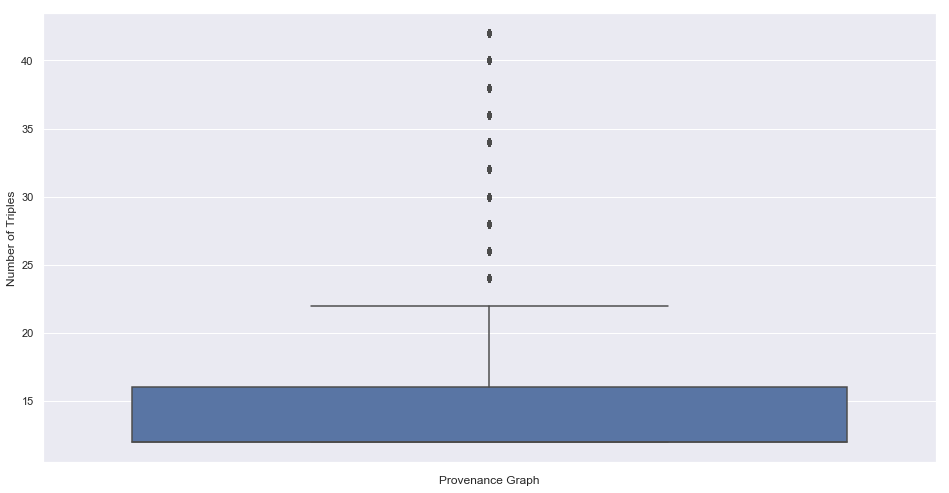

In [13]:
pubInfoTriples.sort()
sns.set(style="whitegrid")
sns.set(rc={'figure.figsize':(16,8.27)})
ax = sns.boxplot(y=pubInfoTriples)
ax.set(xlabel='Provenance Graph', ylabel='Number of Triples')

In [14]:
box_plot = pygal.Box(box_mode="tukey")
box_plot.title = 'Publication Information Distribution'
box_plot.add('pubInfo', pubInfoTriples)
HTML('<embed src={}></embed>'.format(box_plot.render_data_uri()))

HTML(value='<embed src=data:image/svg+xml;charset=utf-8;base64,PD94bWwgdmVyc2lvbj0nMS4wJyBlbmNvZGluZz0ndXRmLTg…

## Draw All Triples in one Box ##

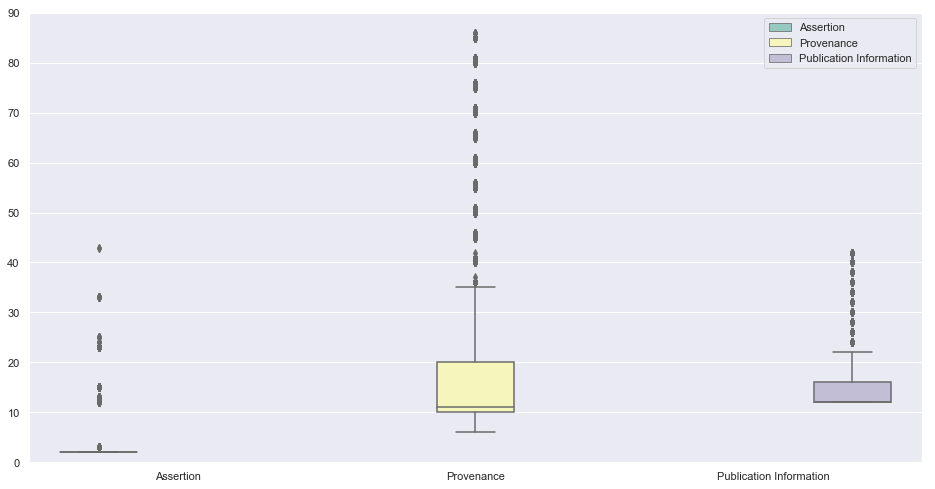

In [15]:
data = {'Graphs': ['Assertion', 'Provenance', 'Publication Information'], 'Triples':[assertions, provenanceTriples, pubInfoTriples]}

sns.set(style="whitegrid")
sns.set(rc={'figure.figsize':(16,8.27)})
ax = sns.boxplot(x="Graphs", y="Triples", hue="Graphs", data=data, palette="Set3")
ax.set_ylim(0, 90);

## Check Predicates ##

In [27]:
query = """
prefix np: <http://www.nanopub.org/nschema#>

        select distinct ?p where {
          graph ?h {
            ?_np_iri a np:Nanopublication ;
              np:hasProvenance ?i .
          }
          graph ?i {?s ?p ?o}.
    }"""

resultsPredicates = queryDisGeNET(query)

In [29]:
#print(resultsPredicates)
predicates = []
for result in resultsPredicates["results"]["bindings"]:
    predicates.append(result["p"]["value"])

for p in predicates:
    print(p + '\n')
    #splitPredicate = p.split("#")
    #print(splitPredicate[1] + '\n')

http://www.w3.org/1999/02/22-rdf-syntax-ns#type

http://www.w3.org/2000/01/rdf-schema#comment

http://purl.org/net/provenance/ns#usedData

http://purl.org/ontology/wi/core#evidence

http://www.w3.org/ns/prov#wasDerivedFrom

http://purl.org/dc/terms/identifier

http://www.w3.org/ns/prov#PrimarySource

http://www.w3.org/ns/prov#wasGeneratedBy

http://www.w3.org/2000/01/rdf-schema#label

http://www.w3.org/2002/07/owl#closeMatch



## Check Subjects ##

In [30]:
query = """
prefix np: <http://www.nanopub.org/nschema#>

        select distinct ?s where {
          graph ?h {
            ?_np_iri a np:Nanopublication ;
              np:hasProvenance ?i .
          }
          graph ?i {?s ?p ?o}.
    }"""

resultSubjects = queryDisGeNET(query)

In [35]:
subjects = []
for result in resultSubjects["results"]["bindings"]:
    subjects.append(result["s"]["value"])

for s in subjects:
    splitSubject = s.split("#")
    if(len(splitSubject)>2):
        print(splitSubject[2] + '\n')
    else:
        print(splitSubject[0] + '\n')

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1




_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3




_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2



_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14



_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2



_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2


_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16




_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1


_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1


_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_


_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11


_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8



_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4


_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_3


_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_


_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2




_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_


_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1



_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4


_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_


_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1



_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10


_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12



_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_


_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7


_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8


_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5




_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_

_8

_9

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6


_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_10

_11

_

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_


_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_


_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1




_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1



_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1



_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5



_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2


_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1


_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2



_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1



_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14



_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4




_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5


_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_1

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8


_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2



_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6



_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3




_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1


_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3


_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1


_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2



_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_


_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3



_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8


_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8


_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2


_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2



_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2



_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9



_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2



_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2


_4

_5

_4

_5

_4

_5

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7



_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4




_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4



_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5



_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1


_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5


_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_31

_32

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2


_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17



_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2


_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_1


_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_4

_5

_4

_5

_4

_4

_4

_5

_4

_5

_4

_4



_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2


_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4



_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2



_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1




_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10



_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3




_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2


_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1


_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10


_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5


_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_4



_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6



_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5


_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3


_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4


_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3


_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_31

_32

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2


_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7



_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_


_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2



_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9




_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_


_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4




_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4


_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1



_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3



_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3



_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_1


_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11




_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14



_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_


_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4


_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3




_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5



_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2



_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_10

_7

_8

_9

_10

_7

_8

_9

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_10

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5


_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1




_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4




_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_


_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2


_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14


_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_


_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_


_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_31

_32

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2



_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_31

_32

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1




_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_31

_32

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1




_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_4

_5

_4

_5

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_


_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_


_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_


_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2




_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_


_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2



_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10




_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_


_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10


_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1



_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_31

_32

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2


_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3


_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_


_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_


_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4



_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7




_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_


_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4




_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5



_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5



_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_10

_7

_8

_9

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_10

_7

_8

_9

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_10

_7

_8

_9

_4



_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3



_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2


_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_


_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10




_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_


_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8




_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4



_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_


_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_


_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24



_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2



_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_


_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17



_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_


_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17


_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15



_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2



_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2




_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_


_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_


_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4


_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2


_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5



_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11



_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_1

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_1

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_


_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_


_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5



_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6


_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15


_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_


_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8


_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8


_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_1

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9


_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_4

_5

_4

_

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5


_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2


_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2


_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_


_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5


_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_


_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_

_5

_4

_5

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2


_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_3

_4

_5

_6

_7

_8




_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4



_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_


_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4



_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_4

_5

_4

_5

_4

_5

_4

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2




_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3



_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1


_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7


_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4




_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10


_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion


assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion



assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

assertion

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1


_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8




_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_


_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_31

_32

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4



_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4



_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_31

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7


_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7



_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2



_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2




_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16



_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7


_9

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2




_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9



_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5



_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12




_7

_8

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_29

_3

_30

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2


_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_


_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2



_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7




_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_4

_5

_4

_5

_4

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16



_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8



_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4


_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7


_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4




_2

_3

_4

_5

_6

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_23

_24

_25

_26

_27

_28

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_4

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4


_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_10

_7

_8

_9

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4


_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_4

_4

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1



_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3


_7

_8

_9

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_19

_2

_20

_21

_22

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_16

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_5

_6

_1

_10

_11

_12

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_15

_1


_2

_1

_2

_1

_2

_3

_4

_5

_6

_7

_8

_1

_2

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_1

_10

_11

_12

_13

_14

_15

_16

_17

_18

_2

_3

_4

_5

_6

_7

_8

_9

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_3

_4

_1

_10

_11

_12

_13

_14

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_3

_4

_5

_6

_1

_2

_3

_4

_5

_6

_7

_8

_1

_10

_2

_3

_4

_5

_6

_7

_8

_9

_1

_2

_1

_2

_3

_4

_1

_2

_1

_2

_1

_2

_1

_2

_1

_2

_3

_4

_5

_6

_1

_2

_1

_2

_3

_4

_1

_2

_3

_4

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_5

_4

_

## Check Objects ##

In [46]:
query = """
prefix np: <http://www.nanopub.org/nschema#>

        select distinct ?o where {
          graph ?h {
            ?_np_iri a np:Nanopublication ;
              np:hasProvenance ?i .
          }
          graph ?i {?s ?p ?o}.
    }LIMIT 2000"""

resultObjects = queryDisGeNET(query)

In [48]:
objects = []
for result in resultObjects["results"]["bindings"]:
    objects.append(result["o"]["value"])

for o in objects:
    splitObject = s.split("#")
    print(splitObject[2])
    

_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_4
_

## All Authors ##

In [15]:
query = """
prefix np: <http://www.nanopub.org/nschema#>
prefix npx: <http://purl.org/nanopub/x/>
prefix pav: <http://swan.mindinformatics.org/ontologies/1.2/pav/>
prefix prov: <http://www.w3.org/ns/prov#>

select distinct ?author where {
  graph ?h {
    ?np a np:Nanopublication .
    ?np np:hasPublicationInfo ?pubinfo .
  }
  graph ?pubinfo {
    ?np pav:authoredBy ?author .
  }
}"""

resultsAuthors = queryDisGeNET(query)

## Testing Code ##

## All Creators ##

In [16]:
query = """
prefix np: <http://www.nanopub.org/nschema#>
prefix npx: <http://purl.org/nanopub/x/>
prefix dct: <http://purl.org/dc/terms/>
prefix pav: <http://swan.mindinformatics.org/ontologies/1.2/pav/>
prefix prov: <http://www.w3.org/ns/prov#>

select distinct ?creator where {
  graph ?h {
    ?np a np:Nanopublication .
    ?np np:hasPublicationInfo ?pubinfo .
  }
  graph ?pubinfo {
    ?np (pav:wasGeneratedBy) ?creator .
  }
}"""

resultsCreator = queryDisGeNET(query)

## Which creator is the author of how many nanopublications

In [12]:
dicCreator_authors = {}
print(len(resultsCreator["results"]["bindings"]))
print(len(resultsAuthors["results"]["bindings"]))
for result in resultsCreator["results"]["bindings"]:
    creator = result["creator"]["value"]
    if dicCreator_authors.get(creator) is None:
        for result1 in resultsAuthors["results"]["bindings"]:
            author = result1["author"]["value"]
            if creator == author:
                if dicCreator_authors.get(creator) is None:
                    dicCreator_authors[creator] = 1
                else:
                    count = dicCreator_authors.get(creator)
                    count = count + 1
                    dicCreator_authors[creator] = count

    

0
0


In [46]:
dicCreator_authors

{}

## Which author is the creator of how many nanopublications

In [47]:
dicAuthor_Creator = {}
for result in resultsAuthors["results"]["bindings"]:
    author = result["author"]["value"]
    if dicAuthor_Creator.get(author) is None:
        for result1 in resultsCreator["results"]["bindings"]:
            creator = result1["creator"]["value"]
            if creator == author:
                if dicAuthor_Creator.get(author) is None:
                    dicAuthor_Creator[author] = 1
                else:
                    count = dicAuthor_Creator.get(author)
                    count = count + 1
                    dicAuthor_Creator[author] = count

In [48]:
dicAuthor_Creator

{}